## BSAN6070 CA-01 <br> Housing Predictions 
#### Tina Brauneck<br>1/25/2025

Description: This code contains a data quality report and data exploration for the housing price dataset.<br><br><br>

#### Table of Contents
##### &emsp; Step 1: Generating an Analytics Base Table (ABT)

##### &emsp; Step 2: Assessing Data Quality

&emsp; &emsp; &emsp; 2A. Data Quality Report: Continuous Features <br>
&emsp; &emsp; &emsp; 2B. Data Quality Report: Categorical Features <br>
&emsp; &emsp; &emsp; 2C. Dropping Low-Quality Features <br>
&emsp; &emsp; &emsp; 2D. Cardinality Checks <br>

##### &emsp; Step 3: Data Exploration

&emsp; &emsp; &emsp; 3A. Data Distribution <br>
&emsp; &emsp; &emsp; &emsp; Histograms <br>
&emsp; &emsp; &emsp; &emsp; Bar Charts <br>
&emsp; &emsp; &emsp; 3B. Feature/Target Relationships <br>
&emsp; &emsp; &emsp; &emsp; Scatterplot Matrix <br>
&emsp; &emsp; &emsp; &emsp; Correlation Matrix <br>

##### &emsp; Step 4: Data Preparation

&emsp; &emsp; &emsp; &emsp; 4A. Dropping Features<br>
&emsp; &emsp; &emsp; &emsp; 4B. Encoding<br>
&emsp; &emsp; &emsp; &emsp; 4C. Outlier Handing <br>
&emsp; &emsp; &emsp; &emsp; 4D. Dropping Rows <br>
&emsp; &emsp; &emsp; &emsp; 4E. Transformations<br>

 <br><br>

### Step 1: Generating an Analytics Base Table (ABT)

In [15]:
# This step puts our data into a dataframe and provides a first look at the data.

In [16]:
# Optional working directory set up. Change the path and uncomment lines below to change the working directory.
#import os
#os.chdir(r"C:\Users\ttesn\OneDrive\Documents\MSBA\BSAN 6070\Computer Assignments\CA-01")
#print(os.getcwd()) 

In [17]:
# Optional install. Uncomment and install if not already installed
# pip install plotnine pandas
# pip install plotly

In [90]:
#Package imports
import matplotlib
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from plotnine import ggplot, aes, geom_histogram, facet_wrap, geom_bar
from plotnine.data import mpg

In [19]:
df = pd.read_csv("https://github.com/ArinB/MSBA-CA-Data/raw/refs/heads/main/CA01/house-price-train.csv") # read in the data

In [203]:
## print the DataFrame's shape, i.e., number of rows and columns
print(df.shape)

(1460, 81)


In [20]:
df.head() #preview the data

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [21]:
df.tail() #preview the data

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1455,1456,60,RL,62.0,7917,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,8,2007,WD,Normal,175000
1456,1457,20,RL,85.0,13175,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,MnPrv,NaN,0,2,2010,WD,Normal,210000
1457,1458,70,RL,66.0,9042,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,GdPrv,Shed,2500,5,2010,WD,Normal,266500
1458,1459,20,RL,68.0,9717,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,4,2010,WD,Normal,142125
1459,1460,20,RL,75.0,9937,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,6,2008,WD,Normal,147500


### Step 2: Assessing Data Quality

In [23]:
# This function determines if the feature is categorial or numerical

In [24]:
df.dtypes

Id                 int64
MSSubClass         int64
MSZoning          object
LotFrontage      float64
LotArea            int64
                  ...   
MoSold             int64
YrSold             int64
SaleType          object
SaleCondition     object
SalePrice          int64
Length: 81, dtype: object

In [25]:
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 200)

In [26]:
pd.set_option('display.width', 1000)

In [27]:
# This function generates a Data Quality Report

def data_quality_report(df, report_type):
    continuous_report = pd.DataFrame(columns=[
        'Feature', 'Count', '% Missing', 'Card.', '1st Qrt.', 'Mean', 'Median', '3rd Qrt.', 'Max', 'Std. Dev.'
    ])

    categorical_report = pd.DataFrame(columns=[
        'Feature', 'Count', '% Missing', 'Card.', 'Mode', 'Mode Freq.', 'Mode %', '2nd Mode', '2nd Mode Freq.', '2nd Mode %'
    ])
    
    for col in df.columns:
        if pd.api.types.is_numeric_dtype(df[col]): 
            count = df[col].count()
            missing_percentage = df[col].isnull().mean() * 100
            cardinality = df[col].nunique()
            first_quartile = df[col].quantile(0.25)
            mean = df[col].mean()
            median = df[col].median()
            third_quartile = df[col].quantile(0.75)
            max_value = df[col].max()
            std_dev = df[col].std()
            
            continuous_report = pd.concat([continuous_report, pd.DataFrame([{
                'Feature': col,
                'Count': count,
                '% Missing': missing_percentage,
                'Card.': cardinality,
                '1st Qrt.': first_quartile,
                'Mean': mean,
                'Median': median,
                '3rd Qrt.': third_quartile,
                'Max': max_value,
                'Std. Dev.': std_dev
            }])], ignore_index=True)

        else:
            count = df[col].count()
            missing_percentage = df[col].isnull().mean() * 100
            cardinality = df[col].nunique()
            mode = df[col].mode()
            #mode_freq = sum(df[col]==mode)

            categorical_report = pd.concat([categorical_report, pd.DataFrame([{
                'Feature': col,
                'Count': count,
                '% Missing': missing_percentage,
                'Card.': cardinality,
                'Mode': mode,
                #'Mode Freq.': mode_freq
            }])],ignore_index=True)

    if report_type == "cont":
        return continuous_report

    elif report_type == "cat":
        return categorical_report
        
    else:
        print("error: report type options are cat or cont")
        
   # print("Continuous Report")
   # print(" ")
   # print("Categorical Report")
    #return continuous_report, categorical_report

In [28]:
dqr_cont = data_quality_report(df,"cont")

C:\Users\ttesn\AppData\Local\Temp\ipykernel_30488\1714698451.py:24: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
C:\Users\ttesn\AppData\Local\Temp\ipykernel_30488\1714698451.py:44: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.


In [29]:
dqr_cat = data_quality_report(df,"cat")

C:\Users\ttesn\AppData\Local\Temp\ipykernel_30488\1714698451.py:24: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
C:\Users\ttesn\AppData\Local\Temp\ipykernel_30488\1714698451.py:44: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.


#### 2A. Data Quality Report: Continuous Features

In [31]:
dqr_cont

,Feature,Count,% Missing,Card.,1st Qrt.,Mean,Median,3rd Qrt.,Max,Std. Dev.
0,Id,1460,0.000000,1460,365.75,730.500000,730.5,1095.25,1460,421.610009
1,MSSubClass,1460,0.000000,15,20.00,56.897260,50.0,70.00,190,42.300571
2,LotFrontage,1201,17.739726,110,59.00,70.049958,69.0,80.00,313.0,24.284752
3,LotArea,1460,0.000000,1073,7553.50,10516.828082,9478.5,11601.50,215245,9981.264932
4,OverallQual,1460,0.000000,10,5.00,6.099315,6.0,7.00,10,1.382997
5,OverallCond,1460,0.000000,9,5.00,5.575342,5.0,6.00,9,1.112799
6,YearBuilt,1460,0.000000,112,1954.00,1971.267808,1973.0,2000.00,2010,30.202904
7,YearRemodAdd,1460,0.000000,61,1967.00,1984.865753,1994.0,2004.00,2010,20.645407
8,MasVnrArea,1452,0.547945,327,0.00,103.685262,0.0,166.00,1600.0,181.066207
9,BsmtFinSF1,1460,0.000000,637,0.00,443.639726,383.5,712.25,5644,456.098091


#### 2B. Data Quality Report: Categorical Features

In [33]:
dqr_cat

,Feature,Count,% Missing,Card.,Mode,Mode Freq.,Mode %,2nd Mode,2nd Mode Freq.,2nd Mode %
0,MSZoning,1460,0.000000,5,"0 RL Name: MSZoning, dtype: object",NaN,NaN,NaN,NaN,NaN
1,Street,1460,0.000000,2,"0 Pave Name: Street, dtype: object",NaN,NaN,NaN,NaN,NaN
2,Alley,91,93.767123,2,"0 Grvl Name: Alley, dtype: object",NaN,NaN,NaN,NaN,NaN
3,LotShape,1460,0.000000,4,"0 Reg Name: LotShape, dtype: object",NaN,NaN,NaN,NaN,NaN
4,LandContour,1460,0.000000,4,"0 Lvl Name: LandContour, dtype: object",NaN,NaN,NaN,NaN,NaN
5,Utilities,1460,0.000000,2,"0 AllPub Name: Utilities, dtype: object",NaN,NaN,NaN,NaN,NaN
6,LotConfig,1460,0.000000,5,"0 Inside Name: LotConfig, dtype: object",NaN,NaN,NaN,NaN,NaN
7,LandSlope,1460,0.000000,3,"0 Gtl Name: LandSlope, dtype: object",NaN,NaN,NaN,NaN,NaN
8,Neighborhood,1460,0.000000,25,"0 NAmes Name: Neighborhood, dtype: object",NaN,NaN,NaN,NaN,NaN
9,Condition1,1460,0.000000,9,"0 Norm Name: Condition1, dtype: object",NaN,NaN,NaN,NaN,NaN


#### 2C. Dropping Low-Quality Features

In [35]:
dqr_cat[dqr_cat['% Missing'] > 60]

,Feature,Count,% Missing,Card.,Mode,Mode Freq.,Mode %,2nd Mode,2nd Mode Freq.,2nd Mode %
2,Alley,91,93.767123,2,"0 Grvl Name: Alley, dtype: object",NaN,NaN,NaN,NaN,NaN
38,PoolQC,7,99.520548,3,"0 Gd Name: PoolQC, dtype: object",NaN,NaN,NaN,NaN,NaN
39,Fence,281,80.753425,4,"0 MnPrv Name: Fence, dtype: object",NaN,NaN,NaN,NaN,NaN
40,MiscFeature,54,96.301370,4,"0 Shed Name: MiscFeature, dtype: object",NaN,NaN,NaN,NaN,NaN


In [36]:
dqr_cont[dqr_cont['% Missing'] > 60]

,Feature,Count,% Missing,Card.,1st Qrt.,Mean,Median,3rd Qrt.,Max,Std. Dev.


In [37]:
abt = df.drop(['Id'], axis=1, inplace=False)

In [38]:
# Four categorical feautres are missing values in more than 60% of their observations. We may drop these four categorical features.
# All continuous features have at least 60% of their values present.
# We can drop the ID column. 

#### 2D. Cardinality Checks

If a feature has cardinality of 1, we drop it, because it is no use; all the values are the same.

In [41]:
dqr_cat[dqr_cat['Card.'] == 1]

,Feature,Count,% Missing,Card.,Mode,Mode Freq.,Mode %,2nd Mode,2nd Mode Freq.,2nd Mode %


In [42]:
dqr_cont[dqr_cont['Card.'] == 1]

,Feature,Count,% Missing,Card.,1st Qrt.,Mean,Median,3rd Qrt.,Max,Std. Dev.


In [43]:
# No features have a cardinality of 1.

In [44]:
# Checking for categorical features that have too high a cardinality. These may just be unique identifiers and can be dropped.
dqr_cat[dqr_cat['Card.'] > 50]

,Feature,Count,% Missing,Card.,Mode,Mode Freq.,Mode %,2nd Mode,2nd Mode Freq.,2nd Mode %


In [45]:
# Checking for continuous features that have too low a cardinality. These may actually be encoded categorical features.
dqr_cont[dqr_cont['Card.'] < 30]

,Feature,Count,% Missing,Card.,1st Qrt.,Mean,Median,3rd Qrt.,Max,Std. Dev.
1,MSSubClass,1460,0.0,15,20.0,56.897260,50.0,70.0,190,42.300571
4,OverallQual,1460,0.0,10,5.0,6.099315,6.0,7.0,10,1.382997
5,OverallCond,1460,0.0,9,5.0,5.575342,5.0,6.0,9,1.112799
15,LowQualFinSF,1460,0.0,24,0.0,5.844521,0.0,0.0,572,48.623081
17,BsmtFullBath,1460,0.0,4,0.0,0.425342,0.0,1.0,3,0.518911
18,BsmtHalfBath,1460,0.0,3,0.0,0.057534,0.0,0.0,2,0.238753
19,FullBath,1460,0.0,4,1.0,1.565068,2.0,2.0,3,0.550916
20,HalfBath,1460,0.0,3,0.0,0.382877,0.0,1.0,2,0.502885
21,BedroomAbvGr,1460,0.0,8,2.0,2.866438,3.0,3.0,8,0.815778
22,KitchenAbvGr,1460,0.0,4,1.0,1.046575,1.0,1.0,3,0.220338


### Step 3: Data Exploration

To start exploring, we divide the ABT dataframe into two feature sets: continuous features and categorical features.

In [48]:
# Declare empty lists for the categorical columns and the continuous columns
categorical_cols = []
continuous_cols = []

for col in abt.columns:
    if pd.api.types.is_numeric_dtype(abt[col]):
        continuous_cols.append(col)
    else:
        categorical_cols.append(col)

In [49]:
abt[categorical_cols].head()

,MSZoning,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Heating,HeatingQC,CentralAir,Electrical,KitchenQual,Functional,FireplaceQu,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition
0,RL,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,NaN,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
1,RL,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,Gable,CompShg,MetalSd,MetalSd,NaN,TA,TA,CBlock,Gd,TA,Gd,ALQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,TA,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
2,RL,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Mn,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal
3,RL,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,Gable,CompShg,Wd Sdng,Wd Shng,NaN,TA,TA,BrkTil,TA,Gd,No,ALQ,Unf,GasA,Gd,Y,SBrkr,Gd,Typ,Gd,Detchd,Unf,TA,TA,Y,NaN,NaN,NaN,WD,Abnorml
4,RL,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Av,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,NaN,NaN,NaN,WD,Normal


In [50]:
abt[continuous_cols].head()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
0,60,65.0,8450,7,5,2003,2003,196.0,706,0,150,856,856,854,0,1710,1,0,2,1,3,1,8,0,2003.0,2,548,0,61,0,0,0,0,0,2,2008,208500
1,20,80.0,9600,6,8,1976,1976,0.0,978,0,284,1262,1262,0,0,1262,0,1,2,0,3,1,6,1,1976.0,2,460,298,0,0,0,0,0,0,5,2007,181500
2,60,68.0,11250,7,5,2001,2002,162.0,486,0,434,920,920,866,0,1786,1,0,2,1,3,1,6,1,2001.0,2,608,0,42,0,0,0,0,0,9,2008,223500
3,70,60.0,9550,7,5,1915,1970,0.0,216,0,540,756,961,756,0,1717,1,0,1,0,3,1,7,1,1998.0,3,642,0,35,272,0,0,0,0,2,2006,140000
4,60,84.0,14260,8,5,2000,2000,350.0,655,0,490,1145,1145,1053,0,2198,1,0,2,1,4,1,9,1,2000.0,3,836,192,84,0,0,0,0,0,12,2008,250000


#### 3A. Data Distribution

Histograms

In [92]:
from plotnine import ggplot, aes, geom_histogram, facet_wrap, theme, element_text, theme_classic

# Melt the DataFrame to long format
abt_cont_melted = abt[continuous_cols].melt(var_name='column', value_name='value')

# Create the plot
p = (ggplot(abt_cont_melted, aes(x='value')) +
    geom_histogram(bins=30, fill='deepskyblue', color='black', size=0.1) +  # Add thin line around bars
    facet_wrap('~column', nrow=10, ncol=4, scales='free_x') +
    theme_classic() +  # Apply classic theme
    theme(subplots_adjust={'wspace': 0.25},  # Adjust the width space between plots
        figure_size=(24, 36),  # Increase the figure size (width, height)
        strip_text_x=element_text(size=18),
        axis_text=element_text(size=16),  # Increase axis text size
        #axis_title=element_text(size=40),  # Option to increase axis title size
        #plot_title=element_text(size=36)  # Option to increase plot title size
                 ))


C:\Users\ttesn\anaconda3\Lib\site-packages\plotnine\layer.py:284: PlotnineWarning: stat_bin : Removed 348 rows containing non-finite values.
C:\Users\ttesn\anaconda3\Lib\site-packages\plotnine\themes\themeable.py:2438: FutureWarning: You no longer need to use subplots_adjust to make space for the legend or text around the panels. This parameter will be removed in a future version. You can still use 'plot_margin' 'panel_spacing' for your other spacing needs.


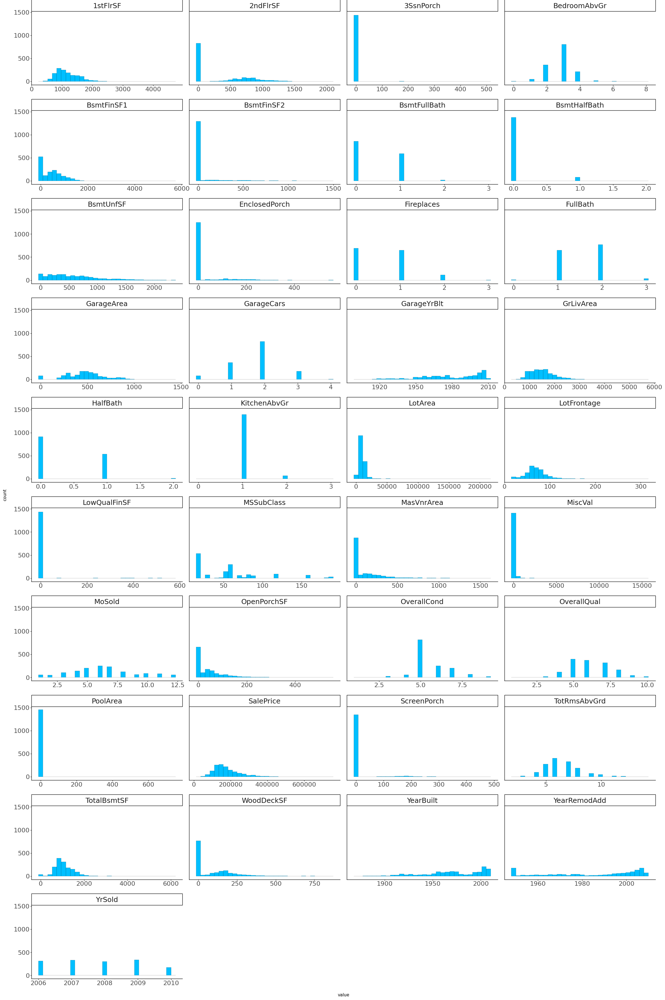

In [86]:
p.draw()

Bar Plots

In [98]:
abt_cat_melted = abt[categorical_cols].melt(var_name='column', value_name='value')

p = (ggplot(abt_cat_melted, aes(x='value')) +
    geom_bar(fill='deepskyblue', color='black', size=0.1) +  # Add thin line around bars
    facet_wrap('~column', nrow=12, ncol=4, scales='free_x') +
    theme_classic() +  # Apply classic theme
    theme(subplots_adjust={'wspace': 0.25},  # Adjust the width space between plots
        figure_size=(24, 36),  # Increase the figure size (width, height)
        strip_text_x=element_text(size=18),
        axis_text=element_text(size=16),  # Increase axis text size
        #axis_title=element_text(size=40),  # Option to increase axis title size
        #plot_title=element_text(size=36)  # Option to increase plot title size
                 ))


C:\Users\ttesn\anaconda3\Lib\site-packages\plotnine\themes\themeable.py:2438: FutureWarning: You no longer need to use subplots_adjust to make space for the legend or text around the panels. This parameter will be removed in a future version. You can still use 'plot_margin' 'panel_spacing' for your other spacing needs.


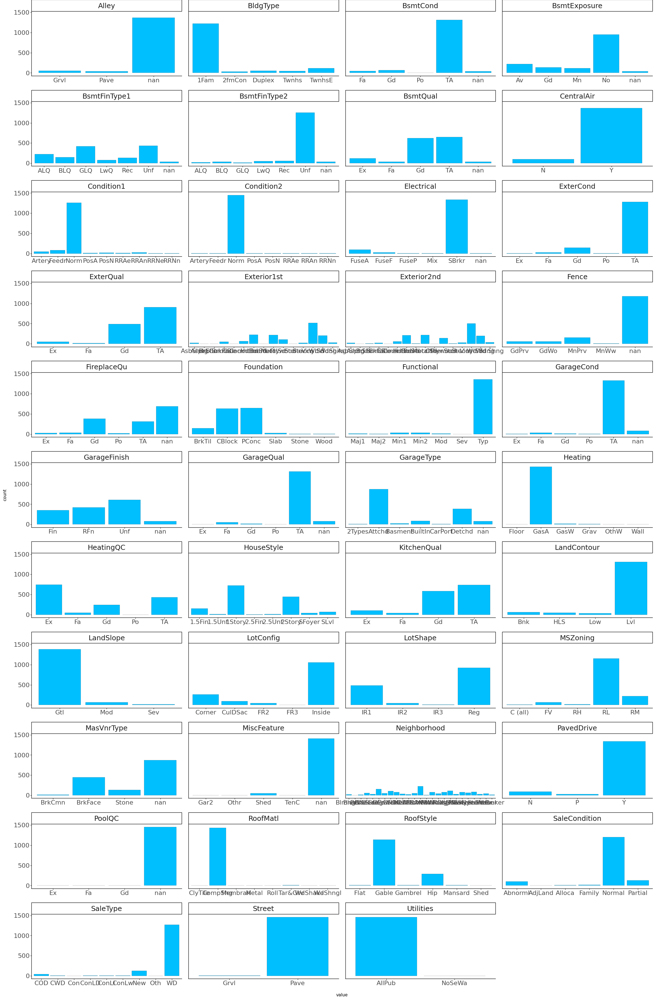

In [100]:
p.draw()

#### 3B. Feature Relationships

Scatter Plot Matrix

In [99]:
## create a pairplot to visualize the relationships between multiple numeric columns
#sns.pairplot(abt[continuous_cols])

In [100]:
plt.show()

In [105]:
# The scatterplot matrix has too many plots to read, so we will remove the features with low cardinality.
continuous_high_card = []
low_card = []

for col in abt.columns:
    if pd.api.types.is_numeric_dtype(abt[col]) and abt[col].nunique() > 15 :
        continuous_high_card.append(col)
    else:
        low_card.append(col)

In [107]:
abt[continuous_high_card].head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageYrBlt,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,MiscVal,SalePrice
0,65.0,8450,2003,2003,196.0,706,0,150,856,856,854,0,1710,2003.0,548,0,61,0,0,0,0,208500
1,80.0,9600,1976,1976,0.0,978,0,284,1262,1262,0,0,1262,1976.0,460,298,0,0,0,0,0,181500
2,68.0,11250,2001,2002,162.0,486,0,434,920,920,866,0,1786,2001.0,608,0,42,0,0,0,0,223500
3,60.0,9550,1915,1970,0.0,216,0,540,756,961,756,0,1717,1998.0,642,0,35,272,0,0,0,140000
4,84.0,14260,2000,2000,350.0,655,0,490,1145,1145,1053,0,2198,2000.0,836,192,84,0,0,0,0,250000


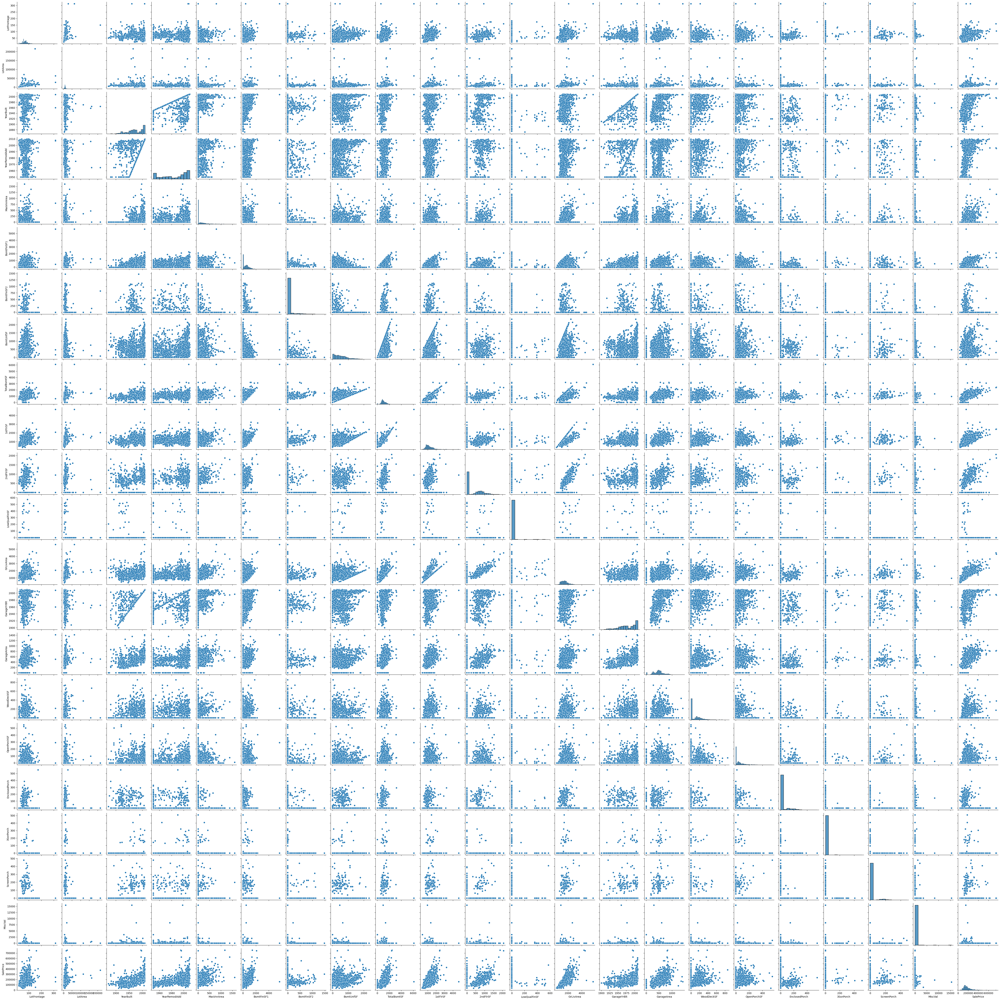

In [104]:
sns.pairplot(abt[continuous_high_card])

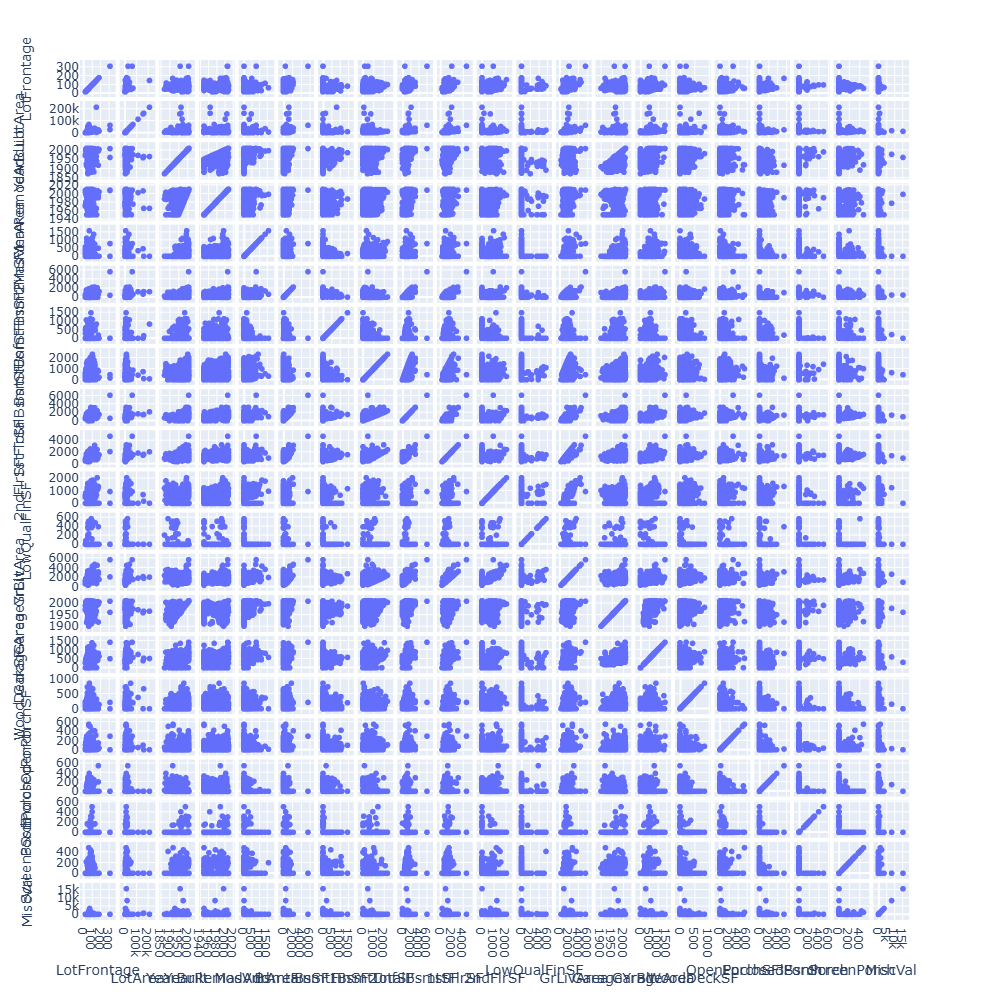

In [122]:
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
import plotly.express as px
import seaborn as sns
import pandas as pd

pd.DataFrame.iteritems = pd.DataFrame.items
# Load a sample dataset

# Create the scatterplot matrix
fig_matrix = px.scatter_matrix(abt[continuous_high_card], dimensions=abt[continuous_high_card].columns[:-1])

fig_matrix.update_layout(
    autosize=False,
    width=1000,
    height=1000
)

In [124]:
# Initialize the Dash app
app = dash.Dash(__name__)

app.layout = html.Div([
    dcc.Graph(id='scatter-matrix', figure=fig_matrix),
    dcc.Graph(id='zoomed-scatter', style={'display': 'none'})
])

@app.callback(
    Output('zoomed-scatter', 'figure'),
    Output('zoomed-scatter', 'style'),
    Input('scatter-matrix', 'clickData')
)
def display_zoomed_scatter(clickData):
    if clickData is None:
        return {}, {'display': 'none'}
    
    point = clickData['points'][0]
    x_col = point['x']
    y_col = point['y']
    
    fig_zoomed = px.scatter(df, x=x_col, y=y_col)
    return fig_zoomed, {'display': 'block'}

if __name__ == '__main__':
    app.run_server(debug=True, port=8052)  # Change the port number to an available one

In [126]:
# This option is interactive. While the labels are had to read when there are too many plots, you can hover over the plots
# to see the values and labels. This tells you which features you are comparing, so you can easily identify the features with high
# correlation.

# Features that exhibit multicollinearilty are:
# BsmtFin SF1 and TotalBsmtSF
# BsmtUnfSF and TotalBsmtSF
# 1stFlSF and TotalBsmtSF
# 1stFlSF and GrLivArea
# 2ndFlSF and GrLivArea

Correlation Matrix

In [132]:
correlation_matrix = abt[continuous_cols].corr()

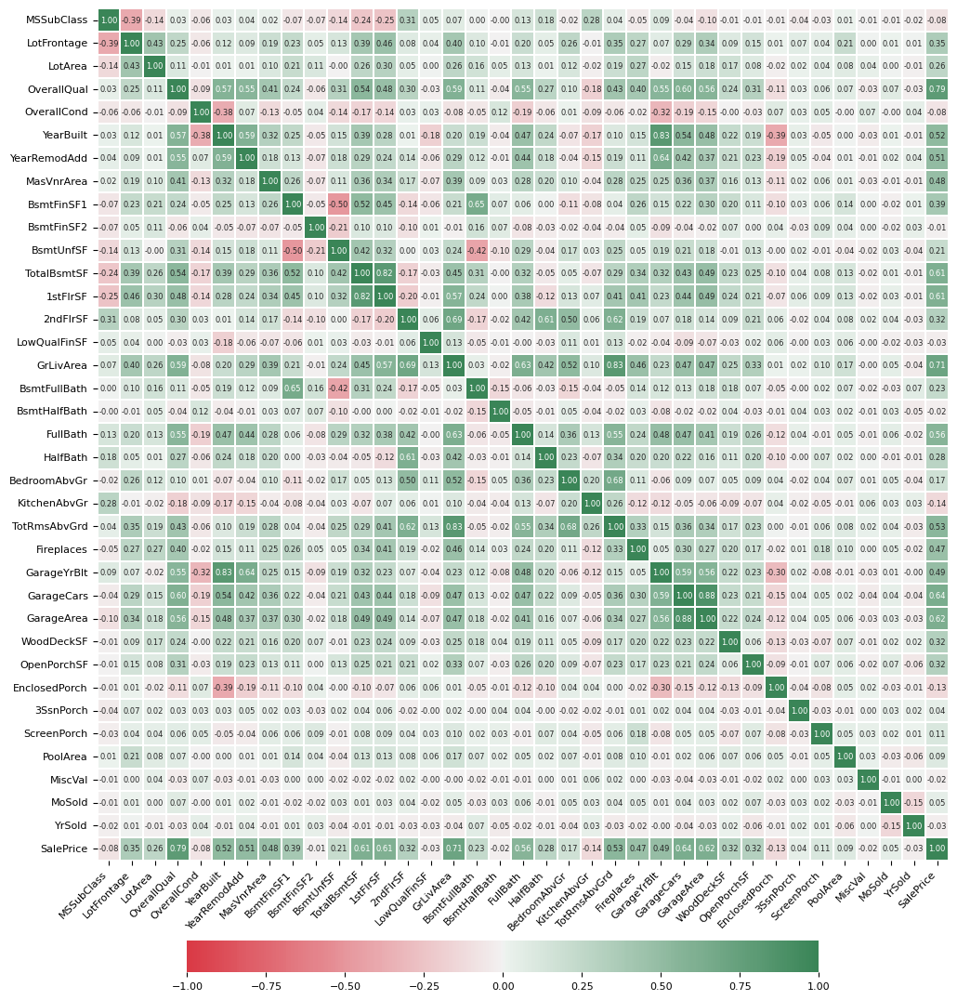

In [168]:
plt.figure(figsize=(17, 17))

axis_corr = sns.heatmap(
correlation_matrix,
vmin=-1, vmax=1, center=0,
cmap=sns.diverging_palette(10, 500, n=500),
    square=True,
    annot=True,  # Show correlation coefficients in each square
    fmt=".2f", # Format the coefficients to 2 decimal places
    annot_kws={"size": 6},  # Set font size for correlation coefficients
    linewidths=.1,  # Add lines between squares for better visibility
    cbar_kws={"shrink": .60, "orientation": "horizontal"}  # Adjust color bar (legend) size
)

# Sets the font size and rotation for the x and y axis labels
plt.xticks(rotation=45, ha='right', fontsize=8)
plt.yticks(rotation=0, fontsize=8)

# Adjust the position of the color legend
cbar = axis_corr.collections[0].colorbar
cbar.ax.tick_params(labelsize=8)
cbar.ax.set_position([0.2, 0.27, 0.6, 0.02])

#for text in axis_corr.texts:
    #text.set_visible(True)

plt.show()

In [117]:
# There is clearly some multicollinearilty issues. For example, GarageYrBlt is highly correlated with YearBuilt. This is unsurprising,
# since some houses are built with a garage; only a portion have a garage added later. We could drop the GarageYrBlt feature, or change
# it to a differential, for example, the number of years after the initial build that the garage was added.


In [134]:
# Now we create a filtered correlation matrix that only shows features with moderate to strong correlations.
# This doesn't mean all correlations shown are strong, but that features with only weak correlations have been removed for readability.

filtered_corr_matrix = correlation_matrix.copy()
for col in correlation_matrix.columns:
    if ((correlation_matrix[col].abs() <= 0.6).all()) or ((correlation_matrix[col].abs() <= 0.6).sum() == len(correlation_matrix) - 1):
        filtered_corr_matrix.drop(col, axis=1, inplace=True)
        filtered_corr_matrix.drop(col, axis=0, inplace=True)

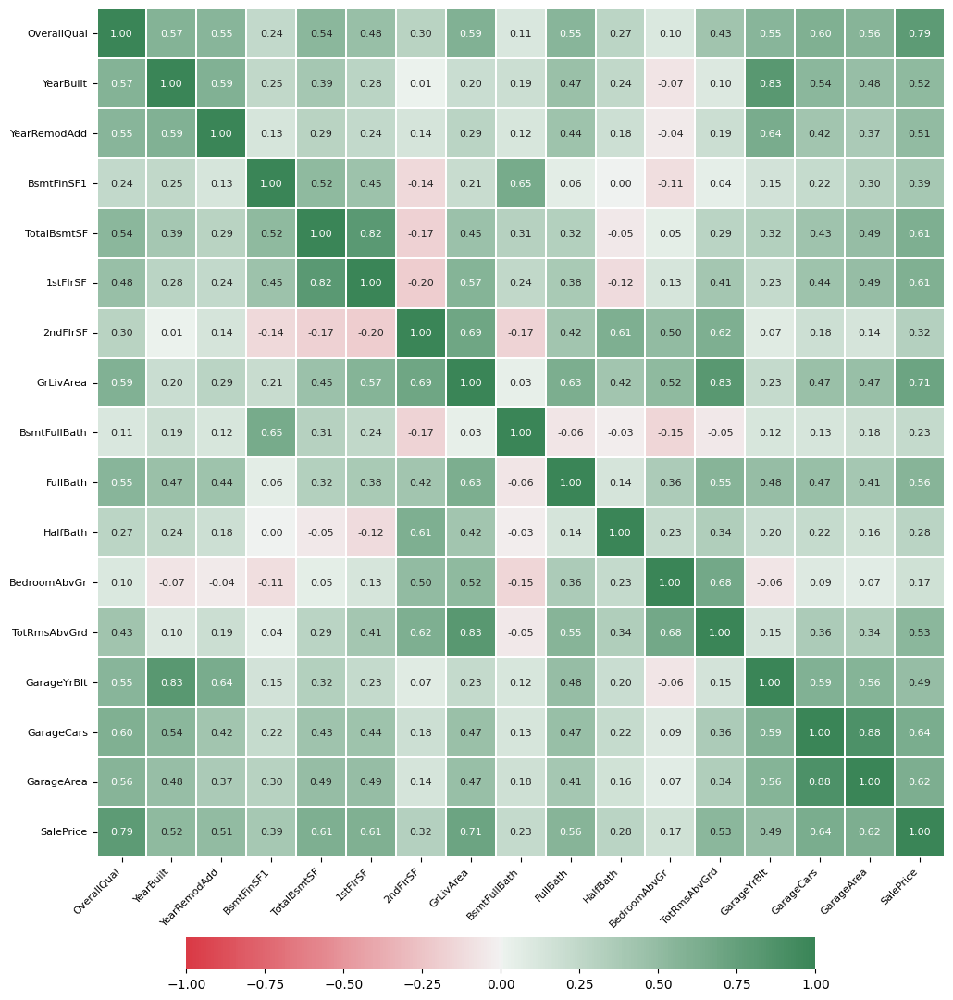

In [142]:
plt.figure(figsize=(17, 17))

axis_corr = sns.heatmap(
filtered_corr_matrix,
vmin=-1, vmax=1, center=0,
cmap=sns.diverging_palette(10, 500, n=500),
    square=True,
    annot=True,  # Show correlation coefficients in each square
    fmt=".2f", # Format the coefficients to 2 decimal places
    annot_kws={"size": 8},  # Set font size for correlation coefficients
    linewidths=.1,  # Add lines between squares for better visibility
    cbar_kws={"shrink": .60, "orientation": "horizontal"}  # Adjust color bar (legend) size
)

# Sets the font size and rotation for the x and y axis labels
plt.xticks(rotation=45, ha='right', fontsize=8)
plt.yticks(rotation=0, fontsize=8)

# Adjust the position of the color legend
cbar = axis_corr.collections[0].colorbar
cbar.ax.tick_params(labelsize=10)
cbar.ax.set_position([0.2, 0.27, 0.6, 0.02])

#for text in axis_corr.texts:
    #text.set_visible(True)

plt.show()

<Figure size 1700x1700 with 0 Axes>

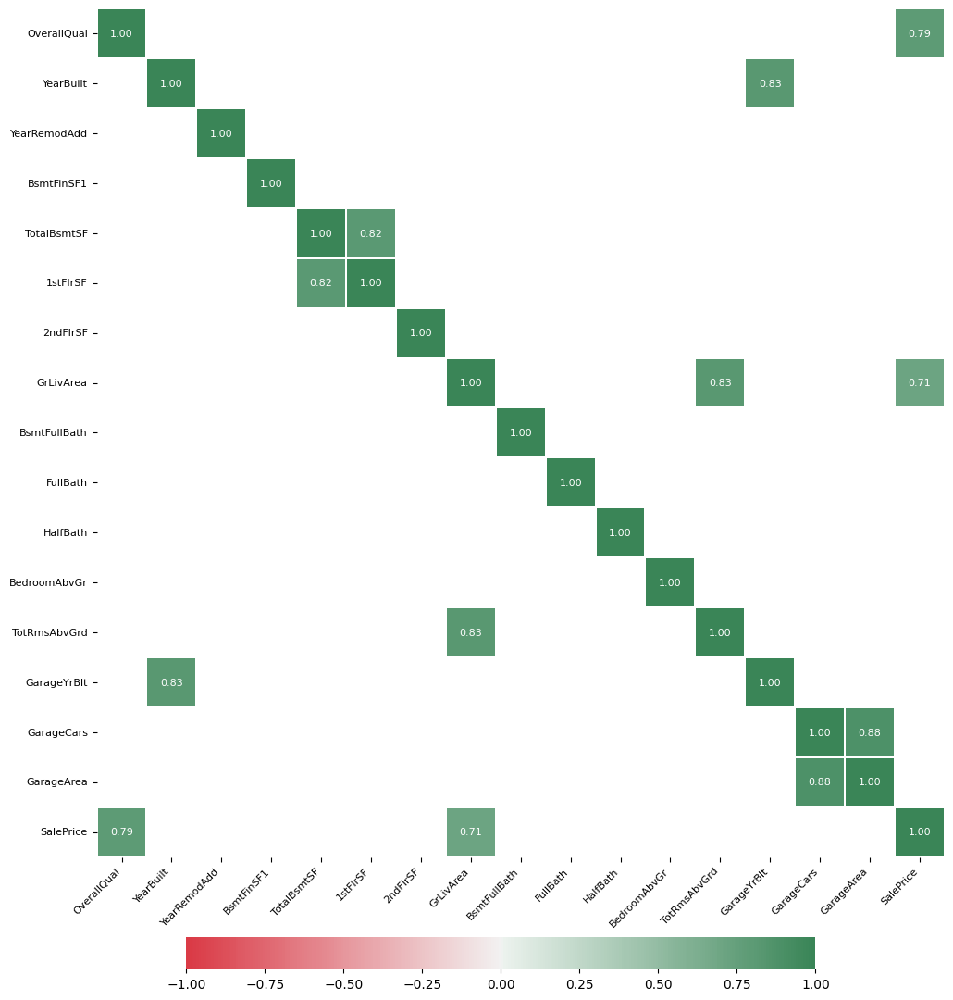

In [150]:
# In addition to the multicollineaity noted with the scatterplot matrix, there are some other features showing high correlation here...


plt.figure(figsize=(17, 17))

axis_corr = sns.heatmap(
filtered_corr_matrix[filtered_corr_matrix > .7],
vmin=-1, vmax=1, center=0,
cmap=sns.diverging_palette(10, 500, n=500),
    square=True,
    annot=True,  # Show correlation coefficients in each square
    fmt=".2f", # Format the coefficients to 2 decimal places
    annot_kws={"size": 8},  # Set font size for correlation coefficients
    linewidths=.1, # Add lines between squares for better visibility
    cbar_kws={"shrink": .60, "orientation": "horizontal"}  # Adjust color bar (legend) size
)

# Sets the font size and rotation for the x and y axis labels
plt.xticks(rotation=45, ha='right', fontsize=8)
plt.yticks(rotation=0, fontsize=8)

# Adjust the position of the color legend
cbar = axis_corr.collections[0].colorbar
cbar.ax.tick_params(labelsize=10)
cbar.ax.set_position([0.2, 0.27, 0.6, 0.02])

#for text in axis_corr.texts:
    #text.set_visible(True)

plt.show()

In [152]:
# Correlations noted in the scatterplot matrix:
# BsmtFin SF1 and TotalBsmtSF
# BsmtUnfSF and TotalBsmtSF
# 1stFlrSF and TotalBsmtSF
# 1stFlrSF and GrLivArea
# 2ndFlrSF and GrLivArea

# Additional correlations noted here:
# GarageYrBlt and YearBuilt
# GarageArea and GarageCars
# GrLivArea and TotRmsAbvGround

# We also see features associated with the target feature, sale price. This is important; they are most likely high predictors.
# The other instances of multicollinearity must be handled.

# Multicollinearity Plan:
#1) Convert GarageYrBlt to GarYrsNewer, the number of years newer the garage is than the house
#2) Drop GarageCars. GarageArea will serve as proxy.
#3) Drop TotRmsAbvGrd. GrLivArea is more highly correlated with price and TotRmsAbvGround has some overlap with other room counts.
#4) Drop TotalBsmtSF. This is already expressed in the other basement features. However, we may want to revisit this decision depending
# on model performance and number of features in the final model.
#5) Drop 1stFlSF.

In [58]:
# Box Plots

In [59]:
# Small multiple bar plots for categorical variables

### Step 4: Data Preparation

In [154]:
# To start, let's make a copy of our ABT.
prepped_abt = abt.copy()

In [158]:
# Imputation and Calculations

prepped_abt['GarYrsNewer'] = prepped_abt['GarageYrBlt'] - prepped_abt['YearBuilt']

#### 4A. Dropping Features

In [164]:
# Dropping features identified earlier with issues of multicollinearity or missing values

prepped_abt.drop(['GarageCars', 'TotRmsAbvGrd', 'TotalBsmtSF', '1stFlrSF', 'GarageYrBlt', 
                 'Alley', 'PoolQC', 'Fence', 'MiscFeature', 'MiscVal'], axis=1, inplace=False)

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,Heating,HeatingQC,CentralAir,Electrical,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageFinish,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MoSold,YrSold,SaleType,SaleCondition,SalePrice,GarAgeSinceYrBuilt
0,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,GasA,Ex,Y,SBrkr,854,0,1710,1,0,2,1,3,1,Gd,Typ,0,NaN,Attchd,RFn,548,TA,TA,Y,0,61,0,0,0,0,2,2008,WD,Normal,208500,0.0
1,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,GasA,Ex,Y,SBrkr,0,0,1262,0,1,2,0,3,1,TA,Typ,1,TA,Attchd,RFn,460,TA,TA,Y,298,0,0,0,0,0,5,2007,WD,Normal,181500,0.0
2,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,GasA,Ex,Y,SBrkr,866,0,1786,1,0,2,1,3,1,Gd,Typ,1,TA,Attchd,RFn,608,TA,TA,Y,0,42,0,0,0,0,9,2008,WD,Normal,223500,0.0
3,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,NaN,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,GasA,Gd,Y,SBrkr,756,0,1717,1,0,1,0,3,1,Gd,Typ,1,Gd,Detchd,Unf,642,TA,TA,Y,0,35,272,0,0,0,2,2006,WD,Abnorml,140000,83.0
4,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,GasA,Ex,Y,SBrkr,1053,0,2198,1,0,2,1,4,1,Gd,Typ,1,TA,Attchd,RFn,836,TA,TA,Y,192,84,0,0,0,0,12,2008,WD,Normal,250000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,60,RL,62.0,7917,Pave,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1999,2000,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,TA,TA,PConc,Gd,TA,No,Unf,0,Unf,0,953,GasA,Ex,Y,SBrkr,694,0,1647,0,0,2,1,3,1,TA,Typ,1,TA,Attchd,RFn,460,TA,TA,Y,0,40,0,0,0,0,8,2007,WD,Normal,175000,0.0
1456,20,RL,85.0,13175,Pave,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1978,1988,Gable,CompShg,Plywood,Plywood,Stone,119.0,TA,TA,CBlock,Gd,TA,No,ALQ,790,Rec,163,589,GasA,TA,Y,SBrkr,0,0,2073,1,0,2,0,3,1,TA,Min1,2,TA,Attchd,Unf,500,TA,TA,Y,349,0,0,0,0,0,2,2010,WD,Normal,210000,0.0
1457,70,RL,66.0,9042,Pave,Reg,Lvl,AllPub,Inside,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,9,1941,2006,Gable,CompShg,CemntBd,CmentBd,NaN,0.0,Ex,Gd,Stone,TA,Gd,No,GLQ,275,Unf,0,877,GasA,Ex,Y,SBrkr,1152,0,2340,0,0,2,0,4,1,Gd,Typ,2,Gd,Attchd,RFn,252,TA,TA,Y,0,60,0,0,0,0,5,2010,WD,Normal,266500,0.0
1458,20,RL,68.0,9717,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,6,1950,1996,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,TA,TA,Mn,GLQ,49,Rec,1029,0,GasA,Gd,Y,FuseA,0,0,1078,1,0,1,0,2,1,Gd,Typ,0,NaN,Attchd,Unf,240,TA,TA,Y,366,0,112,0,0,0,4,2010,WD,Normal,142125,0.0


#### 4B. Encoding

In [166]:
#Depending on the ML package, we may or may not need to encode certain features. We can leave this for the next iteration.

#### 4C. Outlier Handling

In [66]:
# Note: Many of our features are non-normal distributions, so we have to be careful using the IQR.

In [57]:
pd.set_option('display.max_colwidth', None)

In [63]:
outliers_df = pd.DataFrame(columns=['Feature', 'Outliers'])

for col in abt[continuous_cols].columns:
    outliers = []
    Q1 = abt[col].quantile(0.25)
    Q3 = abt[col].quantile(0.75)
    IQR = Q3 - Q1
    for value in abt[col].dropna():  # Ignore NaN values
        if (value < (Q1 - (1.5 * IQR))) or (value > (Q3 + (1.5 * IQR))):
            outliers.append(value)
    outliers_df = pd.concat([outliers_df, pd.DataFrame({'Feature': [col], 'Outliers': [sorted(outliers)]})], ignore_index=True)

In [65]:
outliers_df

,Feature,Outliers
0,MSSubClass,"[160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 160, 180, 180, 180, 180, 180, 180, 180, 180, 180, 180, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, 190, ...]"
1,LotFrontage,"[21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 21.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 24.0, 112.0, 114.0, 114.0, 115.0, 115.0, 116.0, 116.0, 118.0, 118.0, 120.0, 120.0, 120.0, 120.0, 120.0, 120.0, 120.0, 121.0, 121.0, 122.0, 122.0, 124.0, 124.0, 128.0, 129.0, 129.0, 130.0, 130.0, 130.0, 134.0, 134.0, 137.0, 138.0, 140.0, 141.0, 144.0, 149.0, 150.0, 152.0, 153.0, 160.0, 168.0, 174.0, 174.0, 182.0, 313.0, 313.0]"
2,LotArea,"[1300, 1477, 17755, 17871, 17920, 18000, 18030, 18386, 18450, 18800, 18890, 19138, 19296, 19378, 19690, 19900, 20431, 20544, 20781, 20896, 21000, 21286, 21384, 21453, 21535, 21695, 21750, 21750, 21780, 21872, 21930, 22420, 22950, 23257, 23595, 24090, 24682, 25000, 25095, 25286, 25339, 25419, 26142, 26178, 27650, 28698, 29959, 31770, 32463, 32668, 34650, 35133, 35760, 36500, 39104, 40094, 45600, 46589, 50271, 53107, 53227, 53504, 57200, 63887, 70761, 115149, 159000, 164660, 215245]"
3,OverallQual,"[1, 1]"
4,OverallCond,"[1, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, ...]"
5,YearBuilt,"[1872, 1875, 1880, 1880, 1880, 1880, 1882]"
6,YearRemodAdd,[]
7,MasVnrArea,"[420.0, 420.0, 420.0, 423.0, 423.0, 424.0, 424.0, 425.0, 425.0, 426.0, 428.0, 432.0, 435.0, 436.0, 438.0, 442.0, 442.0, 443.0, 448.0, 450.0, 451.0, 452.0, 456.0, 456.0, 456.0, 456.0, 459.0, 464.0, 466.0, 468.0, 472.0, 472.0, 473.0, 479.0, 480.0, 480.0, 481.0, 491.0, 500.0, 506.0, 510.0, 513.0, 513.0, 528.0, 530.0, 541.0, 554.0, 562.0, 564.0, 567.0, 571.0, 573.0, 576.0, 579.0, 584.0, 594.0, 600.0, 603.0, 604.0, 616.0, 621.0, 630.0, 632.0, 640.0, 650.0, 650.0, 651.0, 653.0, 660.0, 660.0, 664.0, 673.0, 705.0, 731.0, 748.0, 760.0, 762.0, 766.0, 768.0, 772.0, 788.0, 796.0, 816.0, 860.0, 870.0, 894.0, 921.0, 922.0, 975.0, 1031.0, 1047.0, 1115.0, 1129.0, 1170.0, 1378.0, 1600.0]"
8,BsmtFinSF1,"[1810, 1880, 1904, 2096, 2188, 2260, 5644]"
9,BsmtFinSF2,"[28, 32, 35, 40, 41, 41, 64, 64, 68, 80, 81, 93, 93, 96, 96, 105, 106, 108, 110, 117, 117, 119, 121, 123, 125, 127, 128, 132, 139, 144, 147, 147, 149, 150, 163, 165, 168, 169, 173, 174, 175, 177, 180, 180, 180, 180, 180, 181, 182, 182, 184, 193, 202, 208, 210, 211, 215, 219, 228, 230, 232, 239, 240, 258, 264, 273, 276, 279, 279, 287, 287, 290, 290, 294, 294, 306, 311, 324, 334, 336, 344, 345, 352, 354, 362, 374, 374, 374, 375, 377, 380, 391, 391, 396, 400, 411, 420, 435, 438, 441, ...]"


Outlier Plan:

MSSubClass - Leave alone; this column is an encoded categorical variable, not a true continuous feature <br>
LotFrontage - TBD; may leave alone; these values may be reasonable for condos and townhome communities <br>
LotArea - Investigate; may be valid for farmhomes <br>
OverallQual - leave alone; 1 is reasonable <br>
OverallCond - leave alone; values are within bounds (1-10) <br>
YearBuilt - remove observations; home age is too extreme to reflect typical conditions and may degrade prediction performance <br>
MasVnrArea - leave alone; values seem reasonable; veneer could be half-wall on front only <br>
BsmtFinSF1 - Investigate; basement size is unreasonably large <br>
BsmtFinSF2 - TBD <br>
BsmtUnfSF - Investigate <br>
TotalBsmtSF - lower end leave alone; upper end needs investigation <br>
1stFlrSF - Investigate; values are high but may be realistic, depending on the region <br>
2ndFlrSF - Investigate; values are high but may be realistic, depending on the region <br>
LowQualFinSF - more context required <br>
GrLivArea - Investigate <br>
BsmtFullBath - Leave alone;  values are within reason <br>
BsmtHalfBath - Leave alone; values are within reason <br>
BedroomAbvGr - Investigate beds > 6 <br>
KitchenAbvGr - Investigate kitchens. Kitchens > 1 should be multi-family dwellings. <br>
TotRmsAbvGrd - Leave alone; values are within reason <br>
Fireplaces - Investigate <br>
GarageArea - Investigate <br>
WoodDeckSF - Typical wooden deck is 300-400 sf, accounding to lawn love. Investigate obs. > 700 sf <br>
OpenPorchSF - Leave alone;  values are within reason <br>
EnclosedPorch - TBD <br>
3SsnPorch - Leave alone;  values are within reason <br>
ScreenPorch - <br>
PoolArea - Leave alone; values are within reason <br>
MiscVal - dropped due to missing values in MiscFeature <br>
SalePrice - Target feature; leave alone. <br>

#### 4D. Dropping Rows

In [180]:
# Dropping year outliers
years_to_drop = [1872, 1875, 1880, 1880, 1880, 1880, 1882]
prepped_abt = prepped_abt[~prepped_abt['YearBuilt'].isin(years_to_drop)]

#### 4E. Transformations

In [ ]:
# Depending on the ML algorythms used, some features may need to be transformed.
# Transformations will be included in the next iteration. 
# Possible transformations:
# Normalization 
# Standardizations
# Clamp Transformation